This notebook demonstrates the basic capabilities of DreamKit. Before starting, make sure to use a GPU:

Edit > Notebook settings > Hardware accelerator > GPU


You'll also need a Hugging Face account and to create an access token:

https://huggingface.co/settings/tokens

In [1]:
!nvidia-smi

Sat Sep 10 11:10:41 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P0    29W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
!pip install https://github.com/jrvangogh/dreamkit/archive/main.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/jrvangogh/dreamkit/archive/main.zip
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


In [3]:
from dreamkit.dreamer import Dreamer
from dreamkit.utils import save_gif, save_mp4
import PIL
import requests
from io import BytesIO

from IPython.display import Image, HTML

In [4]:
from huggingface_hub import notebook_login
notebook_login()

In [5]:
dreamer = Dreamer(root_output_dir='./dreams')

{'trained_betas'} was not found in config. Values will be initialized to default values.
ftfy or spacy is not installed using BERT BasicTokenizer instead of ftfy.


diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

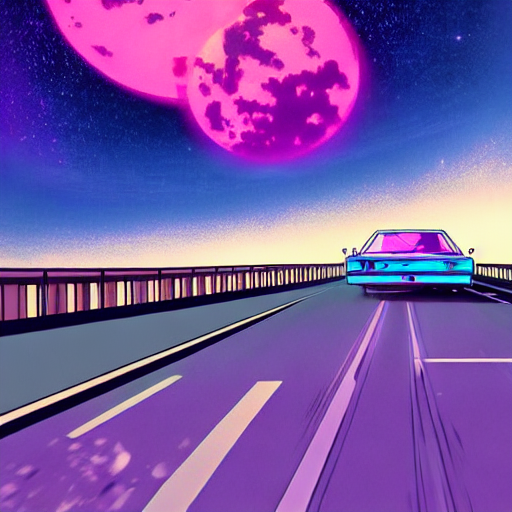

In [6]:
# Basic example of generating a single image from a prompt and seed
name = 'retrowave_car'
prompt = 'cruising down an empty highway under the stars, retrowave artstation'
seed = 189
num_inference_steps = 50

image = dreamer.draw(
    name=name,
    prompt=prompt,
    seed=seed,
    num_inference_steps=num_inference_steps,
)
image

diffuse:   0%|          | 0/85 [00:00<?, ?it/s]

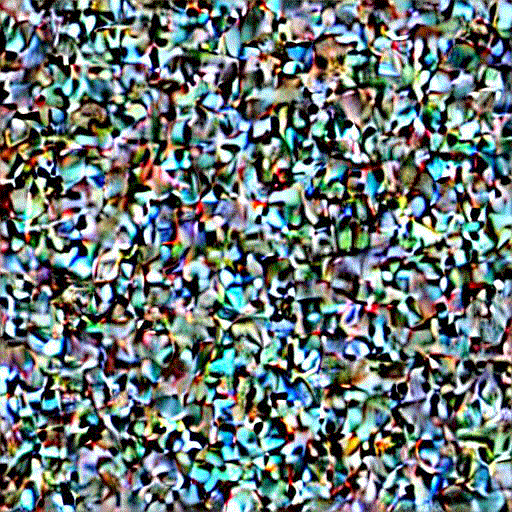

In [7]:
# Use save_frequency to output intermediate images and watch the image appear out of pure noise
name = 'elderly_man'
prompt = 'a photo of an elderly man with graying hair and stark blue eyes contemplating his life'
seed = 7
num_inference_steps = 80
save_frequency = 5

_ = dreamer.draw(
    name=name,
    prompt=prompt,
    seed=seed,
    num_inference_steps=num_inference_steps,
    save_frequency=save_frequency,
)
output_fn = 'elderly_man.gif'
# save_mp4(image_dir=f'{dreamer.root_output_dir}/{name}', output_filename=output_fn, fps=5)  # mp4s not playing properly in colab
save_gif(image_dir=f'{dreamer.root_output_dir}/{name}', output_filename=output_fn, extra_start=5, extra_end=5)
Image(output_fn)

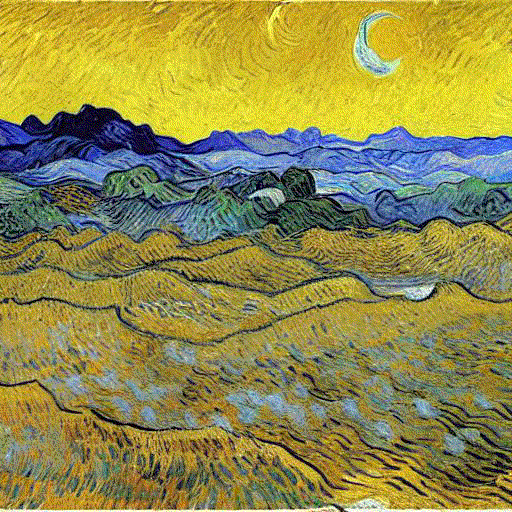

In [9]:
# Interpolate between (prompt, seed) pairs to evolve an image
name = 'desert_to_forest'
prompts = [
    'a barren desert in the sweltering heat, van gogh',
    'a grassland blowing in the wind, van gogh',
    'a lush forest with sunlight peeking through the canopy, van gogh',
]
seeds = [14, 11, 5]
num_interpolate_steps = 5  # 200
num_inference_steps = 50

dreamer.animate_interpolate(
    name=name,
    prompts=prompts,
    seeds=seeds,
    num_interpolate_steps=num_interpolate_steps,
    num_inference_steps=num_inference_steps,
)
output_fn = 'desert_to_forest.gif'
save_gif(image_dir=f'{dreamer.root_output_dir}/{name}', output_filename=output_fn, extra_start=5, extra_end=5)
Image(output_fn)

prompts:   0%|          | 0/1 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

diffuse:   0%|          | 0/51 [00:00<?, ?it/s]

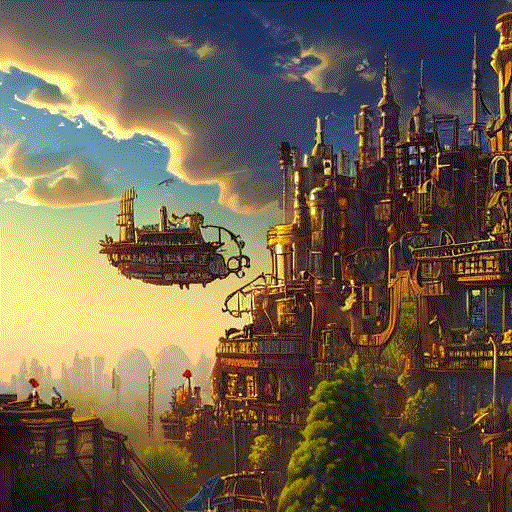

In [10]:
# Or wander around a single prompt's space by only changing the seed
name = 'steampunk_city_interpolate'
prompts = ['a steampunk city floating in the sky, nestled in the clouds, pixar'] * 2
seeds = [3, 11]
num_interpolate_steps = 10  # 200
num_inference_steps = 50

dreamer.animate_interpolate(
    name=name,
    prompts=prompts,
    seeds=seeds,
    num_interpolate_steps=num_interpolate_steps,
    num_inference_steps=num_inference_steps,
)
output_fn = 'steampunk_city_interpolate.gif'
save_gif(image_dir=f'{dreamer.root_output_dir}/{name}', output_filename=output_fn, extra_start=5, extra_end=5)
Image(output_fn)

In [11]:
cat_url = 'https://raw.githubusercontent.com/jrvangogh/dreamkit/main/example/cat.jpg'
dog_url = 'https://raw.githubusercontent.com/jrvangogh/dreamkit/main/example/dog.jpg'

cat_init_img = PIL.Image.open(BytesIO(requests.get(cat_url).content)).convert("RGB")
dog_init_img = PIL.Image.open(BytesIO(requests.get(dog_url).content)).convert("RGB")

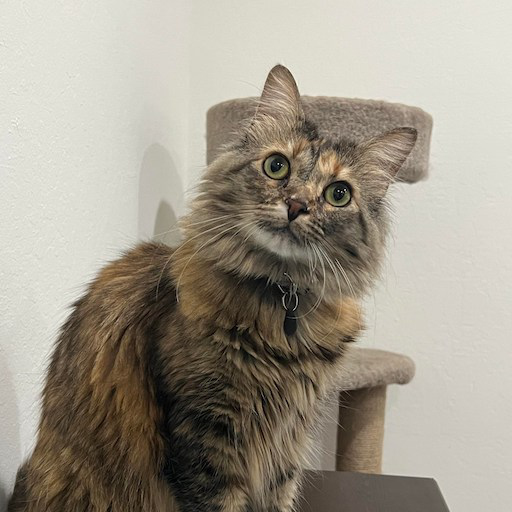

In [14]:
cat_init_img

diffuse:   0%|          | 0/38 [00:00<?, ?it/s]

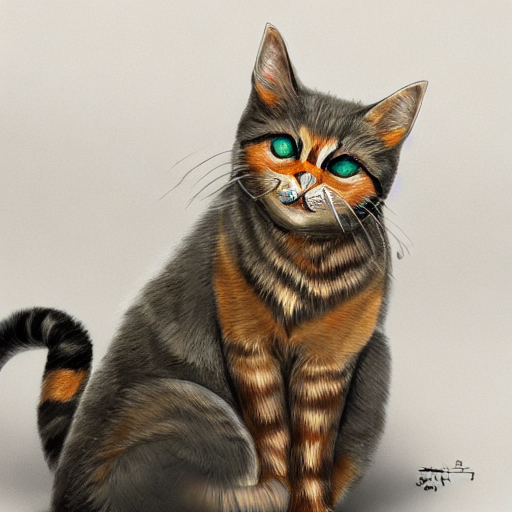

In [12]:
# Have the process start from an existing image
name = 'technocolor_cat'
prompt = 'technocolor cat hypnotizing the viewer, artstation'
seed = 0
init_image_strength = 0.25
num_inference_steps = 50

image = dreamer.draw_from_image(
    name=name,
    prompt=prompt,
    seed=seed,
    init_image=cat_init_img,
    init_image_strength=init_image_strength,
    num_inference_steps=num_inference_steps,
)
image

diffuse:   0%|          | 0/5 [00:00<?, ?it/s]

diffuse:   0%|          | 0/9 [00:00<?, ?it/s]

diffuse:   0%|          | 0/12 [00:00<?, ?it/s]

diffuse:   0%|          | 0/17 [00:00<?, ?it/s]

diffuse:   0%|          | 0/20 [00:00<?, ?it/s]

diffuse:   0%|          | 0/25 [00:00<?, ?it/s]

diffuse:   0%|          | 0/29 [00:00<?, ?it/s]

diffuse:   0%|          | 0/33 [00:00<?, ?it/s]

diffuse:   0%|          | 0/37 [00:00<?, ?it/s]

diffuse:   0%|          | 0/41 [00:00<?, ?it/s]

diffuse:   0%|          | 0/45 [00:00<?, ?it/s]

diffuse:   0%|          | 0/49 [00:00<?, ?it/s]

diffuse:   0%|          | 0/53 [00:00<?, ?it/s]

diffuse:   0%|          | 0/57 [00:00<?, ?it/s]

diffuse:   0%|          | 0/61 [00:00<?, ?it/s]

diffuse:   0%|          | 0/65 [00:00<?, ?it/s]

diffuse:   0%|          | 0/69 [00:00<?, ?it/s]

diffuse:   0%|          | 0/73 [00:00<?, ?it/s]

diffuse:   0%|          | 0/77 [00:00<?, ?it/s]

diffuse:   0%|          | 0/81 [00:00<?, ?it/s]

diffuse:   0%|          | 0/84 [00:00<?, ?it/s]

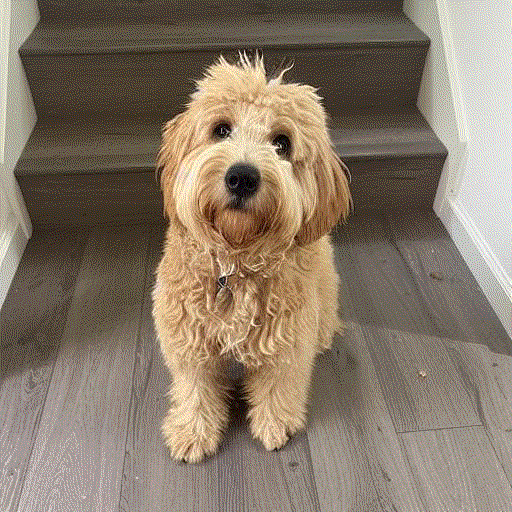

In [13]:
# init_image_strength controls how closely the output will match the input
name = 'rainbow_wolf'
prompt = 'a majestic rainbow fur wolf sitting calmly in front of some stairs, watercolor'
seed = 24
num_inference_steps = 50
strength_steps = 20  # 100

for i in range(strength_steps,-1,-1):
    _ = dreamer.draw_from_image(
        name=name,
        prompt=prompt,
        seed=seed,
        init_image=dog_init_img,
        init_image_strength=i / strength_steps,
        num_inference_steps=num_inference_steps,
        frame=strength_steps-i,
    )
output_fn = 'rainbow_wolf.gif'
save_gif(image_dir=f'{dreamer.root_output_dir}/{name}', output_filename=output_fn, extra_start=5, extra_end=5)
Image(output_fn)